![new-logo-32.png](attachment:new-logo-32.png)

<hr>
<p style="font-size:40px;text-align:center">Take Home - Data Science</p>
<hr>

# The Hotel Bookings Data
Let’s use hotel bookings data from [Antonio, Almeida, and Nunes (2019)](https://www.sciencedirect.com/science/article/pii/S2352340918315191?via%3Dihub) to predict which hotel stays included children and/or babies, based on the other characteristics of the stays such as which hotel the guests stay at, how much they pay, etc.

<img src="https://s3-us-west-2.amazonaws.com/fligoo.data-science/TechInterviews/HotelBookings/header.png"/>

One of the hotels (H1) is a resort hotel and the other is a city hotel (H2). Both datasets share the same structure, with 23 variables describing the 19248 observations of H1 and 30752 observations of H2. Each observation represents a hotel booking. Both datasets comprehend bookings due to arrive between the 1st of July of 2015 and the 31st of August 2017, including bookings that effectively arrived and bookings that were canceled. Since this is hotel real data, all data elements pertaining hotel or custumer identification were deleted.

**Take-Home Goals**
- During **Part I**, you should perform an Exploratory Data Analysis highlighting key findings:
  - Data Quality Check: You must check the quality of the given dataset to make an assessment of how appropriate it is for later Data Science tasks. Propose a set of corrective actions over the data if any.
  - Report insights and conclusions: Describe the results obtained during the exploratory analysis and provide conclusions from a business perspective, supported by plots / tables / metrics.
- In **Part II** you should define and train a model to predict which actual hotel stays included children/babies, and which did not:
  - Feature extraction: Indicate some possible candidates of features that could properly describe the hotels, either from the given columns or from their transformations.
  - Machine Learning modeling: at least one fitted model with the given data. You could use the `children` column as target.
- Finally, on **Part III** you should present the key findings, conclusions and results to non-technical stakeholders.
  
**Requirements**
- Python 3.x & Pandas 1.x
- Paying attention to the details and narrative is far way more important than extensive development.
- Once you complete the assessment, please send a ZIP file of the folder with all the resources used in this work (e.g. Jupyter notebook, Python scripts, text files, images, etc) or share the repository link.
- Have a final meeting with the team to discuss the work done in this notebook and answer the questions that could arise.
- Finally, but most important: Have fun!

**Nice to have aspects**
- Dockerfile to setup environment / Conda environment for isolation.
- Code versioning with Git (you are free to publish it on your own Github/Bitbucket account!).
- Show proficiency in Python: By showing good practices in the structure and documentation, usage of several programming paradigms (e.g. imperative, OOP, functional), etc.


## Part I - Exploratory Data Analisys

In [ ]:
import numpy as np
import pandas as pd

# gráficos
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go

# preprocesamiento de datos
from sklearn.preprocessing import (
    StandardScaler,
    OneHotEncoder,
    LabelEncoder,
)
import missingno as msno
from sklearn.impute import SimpleImputer

# aprendizaje automático supervisado
from random import sample
from sklearn.linear_model import LinearRegression, Ridge
from sklearn.kernel_ridge import KernelRidge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline
from sklearn.model_selection import (
    cross_val_score,
    cross_val_predict,
    GridSearchCV,
    train_test_split,
)
from scipy.stats import loguniform

from sklearn.metrics import mean_squared_error, r2_score

In [ ]:
#Leemos datos y creamos un dataframe llamado hotels

hotels = pd.read_csv('https://s3-us-west-2.amazonaws.com/fligoo.data-science/TechInterviews/HotelBookings/hotels.csv')

In [ ]:
hotels.head(5)

In [ ]:
#Verificamos la "forma" de nuestro dataset, es decir filas por columnas del mismo
hotels.shape

Nuestro dataset completo tiene 50.000 filas y 23 columnas

In [ ]:
#Verifiquemos ahora el tipo de datos por columna y si todas ellas estan completas o presentan valores nulos
hotels.info()

In [ ]:
#La variable date esta en formato object, procedamos a pasarlo a formato fecha

hotels['arrival_date'] = pd.to_datetime(hotels['arrival_date'])

# Verificar el cambio de tipo de datos
print(hotels.dtypes)

Podemos observar que tenemos 1 columna float, 10 interger (es decir, 11 columnas numericas en total), y 12 columnas object. Además solo una de ellas presenta valores nulos, la feature "country"

In [ ]:
#Descriptivo Variables Numericas
hotels.describe(percentiles=[.1, .2, .3, .4, .5, .6, .7, .8, .9, .99]).T

In [ ]:
# Otra manera de realizar el mismo análisis es el siguiente
# Seleccionamos todas las columnas numéricas
numeric_cols = hotels.select_dtypes(include=['number']).columns

# Verificamos cuales son las variables numéricas, vemos los valores únicos y calculamos la cantidad
for col in numeric_cols:
    unique_cases = hotels[col].unique()
    print(f"Columna: {col}")
    print("\n", hotels[col].describe())
    print("\nValue Counts\n", hotels[col].value_counts())
    print(f"{'-'*60}")

print('\n\nVariables numéricas:\n', numeric_cols)

In [ ]:
obj_cols = []

# Verificamos cuales son las variables object, vemos los valores únicos y calculamos la cantidad
for col in hotels:
    if hotels[col].dtype == 'object':
        unique_cases = hotels[col].unique()
        obj_cols.append(col)
        print("\n", hotels[col].describe())
        print("\nValue Counts\n", hotels[col].value_counts())
        print(f"{'-'*60}")

# En esta lista estan todas las variables categóricas que vamos a transformar
print('\n\nVariables categóricas a transformar:\n', obj_cols)

No se observan problemas de nomenclatura en las variables categoricas, es decir, que dos nomenclaturas distintas refieran a la misma clase.

In [ ]:
#Notamos que country tenia valores nulos, ahora calculemos cuanto es ese porcentaje de valores nulos
print("Porcentaje de valores nulos en country = {0:.3f}%".format(
    100*(hotels.country.isna().sum()/len(hotels))))

In [ ]:
msno.matrix(hotels, figsize=(8, 5), fontsize=12, color=[0,0,0.2])

## Análisis Univariado

In [ ]:
# Se define función para la exploración visual
def expl_visual(df_histograma,field):

  f, (ax_box, ax_hist) = plt.subplots(2, sharex=True, gridspec_kw= {"height_ratios": (0.2, 1)})
  mean=df_histograma[field].mean()
  median=df_histograma[field].median()
  mode=df_histograma[field].mode().values[0]

  sns.boxplot(data=df_histograma, x=field, ax=ax_box)
  ax_box.axvline(mean, color='r', linestyle='--')
  ax_box.axvline(median, color='g', linestyle='-')
  ax_box.axvline(mode, color='b', linestyle='-')

  sns.histplot(data=df_histograma, x=field, ax=ax_hist, kde=True)
  ax_hist.axvline(mean, color='r', linestyle='--', label="Mean")
  ax_hist.axvline(median, color='g', linestyle='-', label="Median")
  ax_hist.axvline(mode, color='b', linestyle='-', label="Mode")

  ax_hist.legend()

  ax_box.set(xlabel='')
  plt.show()

  print('Media = ',mean)
  print('Mediana = ',median)
  print('Moda principal = ',mode)

In [ ]:
# Se define función para detección de Outliers

def outlier(df_in, col_name):

    q1 = df_in[col_name].quantile(0.25)
    q3 = df_in[col_name].quantile(0.75)
    iqr = q3-q1 #Interquartile range
    fence_low  = q1-1.5*iqr
    fence_high = q3+1.5*iqr

    print("IQR Limite inferior "+str(fence_low))
    print("IQR Limite superior "+str(fence_high))
    print("IQR = ", iqr)

    df_filtered = df_in.loc[(df_in[col_name] > fence_low) & (df_in[col_name] < fence_high)]
    df_outliers = df_in.loc[(df_in[col_name] < fence_low) | (df_in[col_name] > fence_high)]

    return df_filtered, df_outliers

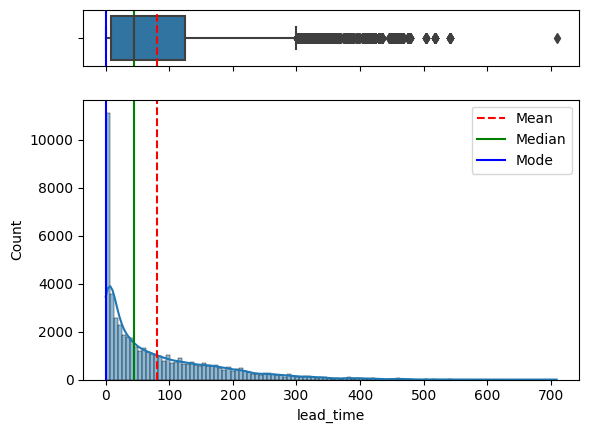

Media =  80.09412
Mediana =  45.0
Moda principal =  0


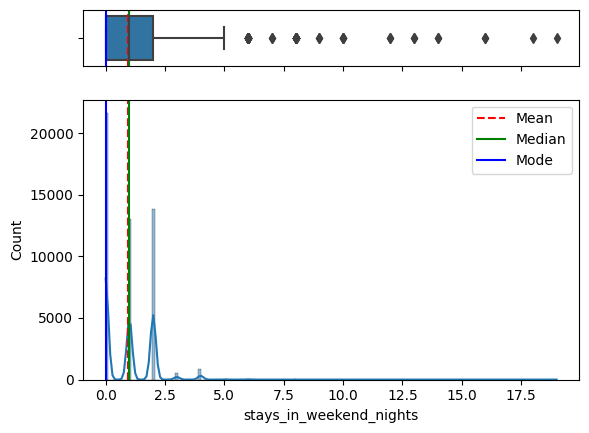

Media =  0.92852
Mediana =  1.0
Moda principal =  0


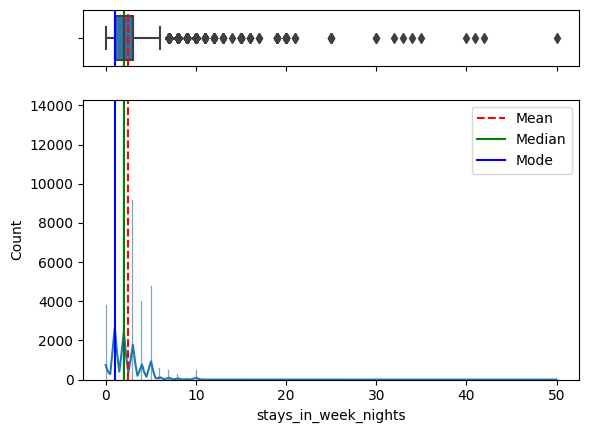

Media =  2.46454
Mediana =  2.0
Moda principal =  1


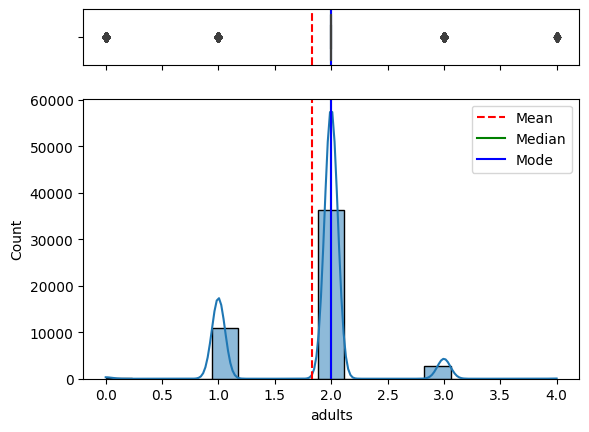

Media =  1.83028
Mediana =  2.0
Moda principal =  2


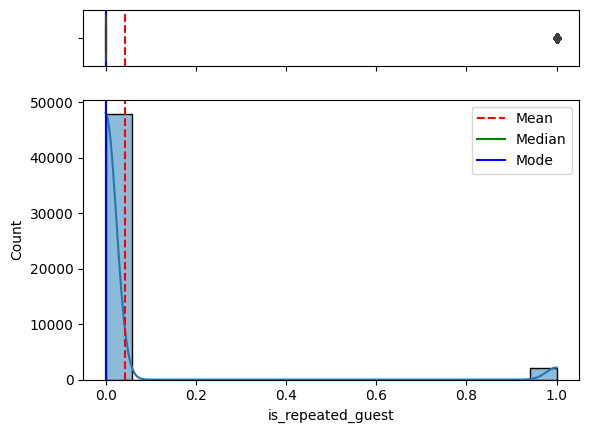

Media =  0.0432
Mediana =  0.0
Moda principal =  0


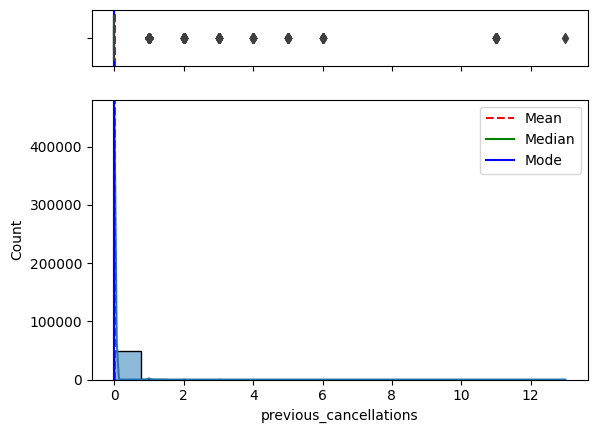

Media =  0.01674
Mediana =  0.0
Moda principal =  0


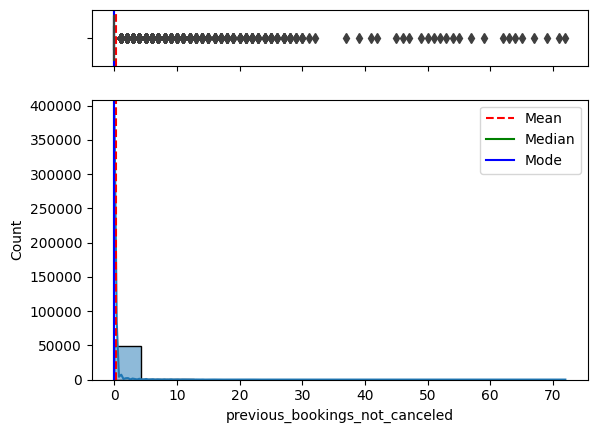

Media =  0.20274
Mediana =  0.0
Moda principal =  0


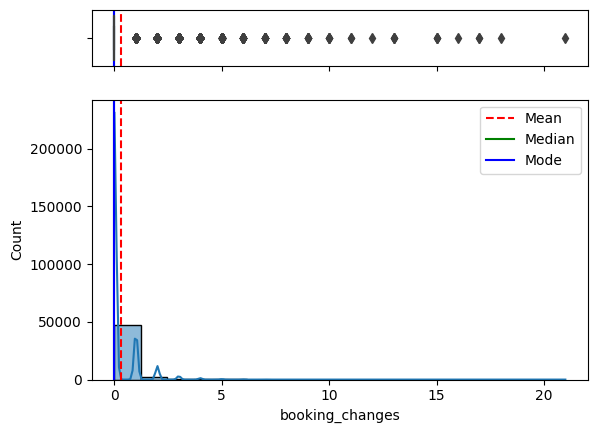

Media =  0.29496
Mediana =  0.0
Moda principal =  0


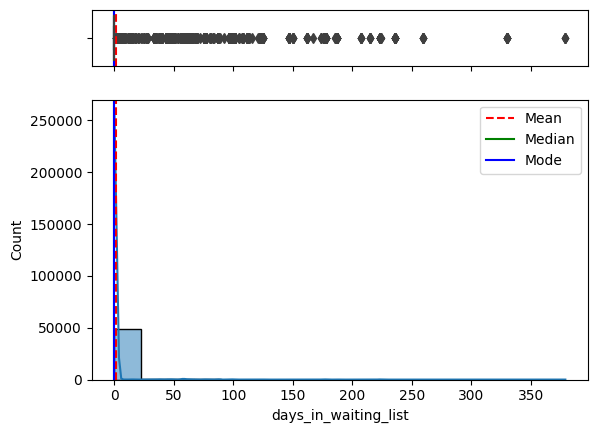

Media =  1.5704
Mediana =  0.0
Moda principal =  0


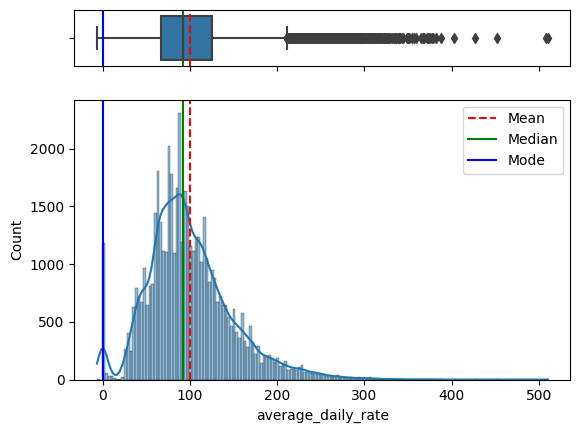

Media =  99.94234240000002
Mediana =  92.5
Moda principal =  0.0


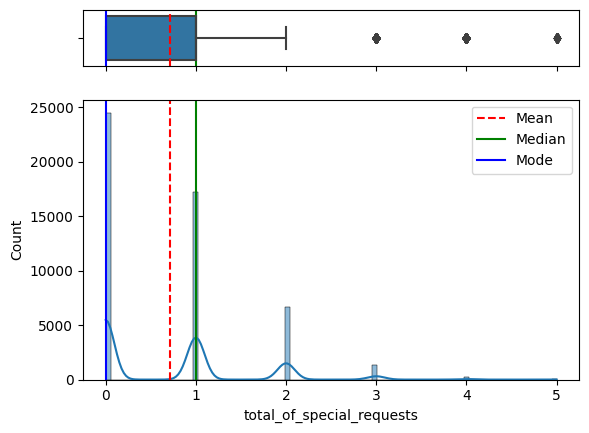

Media =  0.71266
Mediana =  1.0
Moda principal =  0


In [14]:
# Se aplica la función de exploración para visualizar la distribución de variables cuantitativas
for i in hotels.describe().columns:
    expl_visual(hotels,i)

In [ ]:
# Se observan los outliers para lead_time
df_filtered, df_outliers = outlier(hotels,"lead_time")
df_outliers

IQR Limite inferior -167.5
IQR Limite superior 300.5
IQR =  117.0


,hotel,lead_time,stays_in_weekend_nights,stays_in_week_nights,adults,children,meal,country,market_segment,distribution_channel,...,reserved_room_type,assigned_room_type,booking_changes,deposit_type,days_in_waiting_list,customer_type,average_daily_rate,required_car_parking_spaces,total_of_special_requests,arrival_date
15,City_Hotel,423,1,1,2,none,HB,DEU,Offline_TA/TO,TA/TO,...,A,A,0,No_Deposit,0,Transient-Party,122.40,none,1,2017-07-22
55,City_Hotel,504,2,1,2,none,BB,GBR,Offline_TA/TO,TA/TO,...,A,A,0,No_Deposit,0,Transient-Party,112.67,none,1,2017-08-12
58,Resort_Hotel,386,1,3,2,none,BB,GBR,Groups,Corporate,...,A,A,2,No_Deposit,0,Transient-Party,49.00,none,0,2016-10-20
103,City_Hotel,457,0,2,2,none,HB,DEU,Offline_TA/TO,TA/TO,...,A,A,1,No_Deposit,0,Transient-Party,122.40,none,1,2017-08-25
216,City_Hotel,405,0,2,2,none,HB,DEU,Offline_TA/TO,TA/TO,...,A,A,0,No_Deposit,0,Transient-Party,114.40,none,0,2017-07-04
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49942,City_Hotel,405,0,2,2,none,HB,DEU,Offline_TA/TO,TA/TO,...,A,A,0,No_Deposit,0,Transient-Party,114.40,none,0,2017-07-04
49946,City_Hotel,346,0,2,2,none,HB,DEU,Offline_TA/TO,TA/TO,...,A,A,0,No_Deposit,0,Transient-Party,115.00,none,1,2016-09-13
49955,City_Hotel,338,1,2,2,none,BB,FRA,Offline_TA/TO,TA/TO,...,A,A,0,No_Deposit,68,Transient-Party,90.67,none,1,2016-10-07
49988,City_Hotel,316,0,3,1,none,BB,AUT,Groups,TA/TO,...,A,A,1,No_Deposit,0,Transient-Party,0.00,none,0,2016-05-26


In [ ]:
# Se observan los outliers para previous_bookings_not_cancelled
df_filtered, df_outliers = outlier(hotels,"previous_bookings_not_canceled")
df_outliers

IQR Limite inferior 0.0
IQR Limite superior 0.0
IQR =  0.0


,hotel,lead_time,stays_in_weekend_nights,stays_in_week_nights,adults,children,meal,country,market_segment,distribution_channel,...,reserved_room_type,assigned_room_type,booking_changes,deposit_type,days_in_waiting_list,customer_type,average_daily_rate,required_car_parking_spaces,total_of_special_requests,arrival_date
19,Resort_Hotel,7,1,2,2,none,HB,NaN,Online_TA,TA/TO,...,E,I,1,No_Deposit,0,Transient,78.42,parking,1,2016-10-31
42,Resort_Hotel,4,0,1,1,none,BB,PRT,Offline_TA/TO,TA/TO,...,A,D,0,No_Deposit,0,Transient,30.00,none,2,2016-02-10
104,City_Hotel,3,1,1,1,none,BB,FRA,Direct,Direct,...,A,A,0,No_Deposit,0,Transient,80.00,none,2,2017-02-20
129,Resort_Hotel,2,1,0,2,none,BB,PRT,Online_TA,TA/TO,...,A,D,0,No_Deposit,0,Transient,55.00,none,2,2016-02-14
170,City_Hotel,1,0,3,1,none,BB,PRT,Corporate,Corporate,...,A,A,0,No_Deposit,0,Transient,65.00,none,1,2016-05-03
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49931,City_Hotel,0,1,1,1,none,BB,PRT,Groups,TA/TO,...,A,A,0,No_Deposit,0,Transient,40.00,none,0,2016-01-25
49959,City_Hotel,4,0,1,1,none,BB,PRT,Corporate,Corporate,...,A,A,0,No_Deposit,0,Transient,66.00,none,0,2016-02-23
49962,Resort_Hotel,0,0,1,1,none,BB,NaN,Corporate,Corporate,...,A,D,0,No_Deposit,0,Transient,35.00,none,0,2016-11-15
49982,Resort_Hotel,2,0,1,1,none,BB,PRT,Corporate,Corporate,...,A,A,0,No_Deposit,0,Transient,35.00,none,0,2017-02-08


In [ ]:
# Se observan los outliers para previous_bookings_not_cancelled
df_filtered, df_outliers = outlier(hotels,"average_daily_rate")
df_outliers

IQR Limite inferior -18.75
IQR Limite superior 211.25
IQR =  57.5


,hotel,lead_time,stays_in_weekend_nights,stays_in_week_nights,adults,children,meal,country,market_segment,distribution_channel,...,reserved_room_type,assigned_room_type,booking_changes,deposit_type,days_in_waiting_list,customer_type,average_daily_rate,required_car_parking_spaces,total_of_special_requests,arrival_date
6,Resort_Hotel,47,0,2,2,children,BB,ESP,Direct,Direct,...,C,C,0,No_Deposit,0,Transient,289.00,none,1,2017-08-23
40,Resort_Hotel,127,2,5,2,children,HB,PRT,Direct,Direct,...,E,E,4,No_Deposit,0,Transient,334.43,parking,4,2017-08-18
100,Resort_Hotel,81,1,4,2,children,HB,PRT,Direct,Direct,...,A,A,1,No_Deposit,0,Transient,228.75,parking,0,2017-07-05
102,City_Hotel,31,0,1,3,children,BB,ESP,Online_TA,TA/TO,...,F,F,0,No_Deposit,0,Transient,225.40,none,1,2016-08-25
123,City_Hotel,2,0,1,3,none,BB,PRT,Online_TA,TA/TO,...,D,D,0,No_Deposit,0,Transient,230.00,none,1,2017-08-04
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49862,Resort_Hotel,219,1,4,2,children,Undefined,PRT,Direct,Direct,...,A,A,3,No_Deposit,0,Transient,249.38,parking,0,2017-07-24
49925,Resort_Hotel,34,2,2,2,none,HB,ESP,Online_TA,TA/TO,...,A,A,0,No_Deposit,0,Transient,221.00,none,2,2015-08-09
49945,Resort_Hotel,55,1,4,3,children,BB,PRT,Online_TA,TA/TO,...,H,H,0,No_Deposit,0,Transient,286.00,parking,0,2016-08-08
49966,Resort_Hotel,47,0,3,2,children,HB,RUS,Online_TA,TA/TO,...,C,C,0,No_Deposit,0,Transient,255.00,none,2,2015-08-13


In [ ]:
hotels.columns

Index(['hotel', 'lead_time', 'stays_in_weekend_nights', 'stays_in_week_nights',
       'adults', 'children', 'meal', 'country', 'market_segment',
       'distribution_channel', 'is_repeated_guest', 'previous_cancellations',
       'previous_bookings_not_canceled', 'reserved_room_type',
       'assigned_room_type', 'booking_changes', 'deposit_type',
       'days_in_waiting_list', 'customer_type', 'average_daily_rate',
       'required_car_parking_spaces', 'total_of_special_requests',
       'arrival_date'],
      dtype='object')

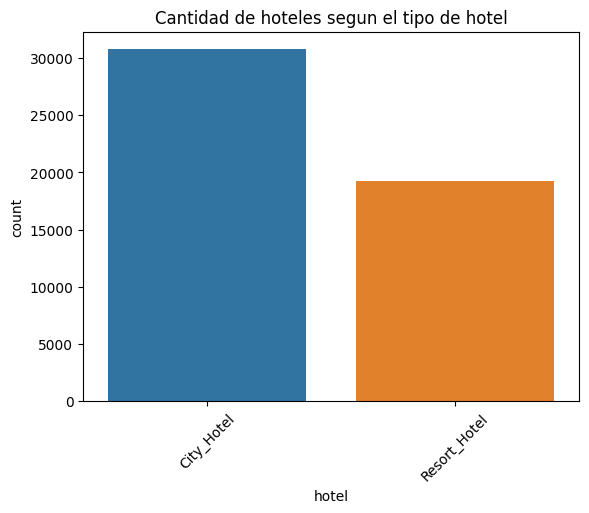

In [ ]:
#Definimos funcion countplot
def plot_count_distribution(data, column, title):
    ax = sns.countplot(x=data[column])
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45)
    ax.set_title(title)
    plt.show()

# Verificamos cantidad de hotels segun el tipo de hotel
plot_count_distribution(hotels, 'hotel', 'Cantidad de hoteles segun el tipo de hotel')


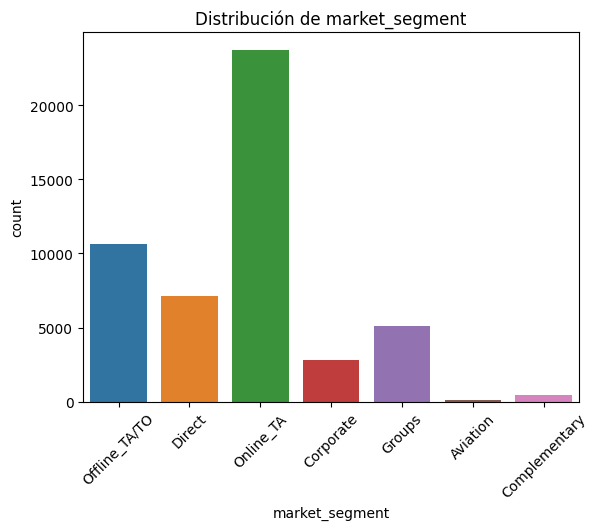

In [ ]:
# Verificamos la distribución del segmento asignado a la reserva
plot_count_distribution(hotels, 'market_segment', 'Distribución de market_segment')

El segmento Online_TA (Online Travel Agents) es el mayoritario, seguido de Offline_TA/TO

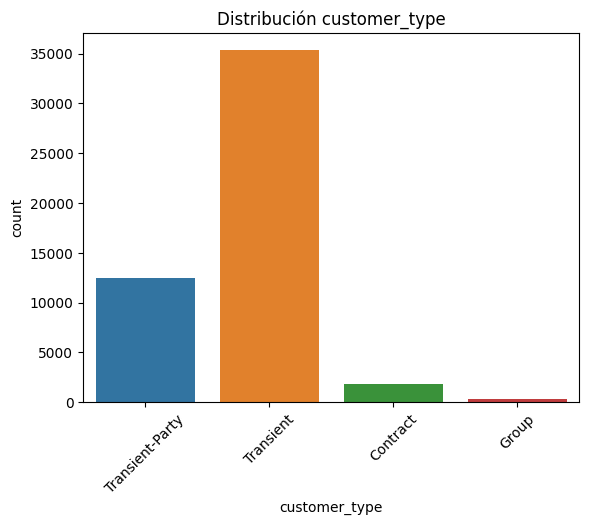

In [ ]:
# Verificamos la distribución de customer_type
plot_count_distribution(hotels, 'customer_type', 'Distribución customer_type')

Casi toda la muestra corresponde a Transiet

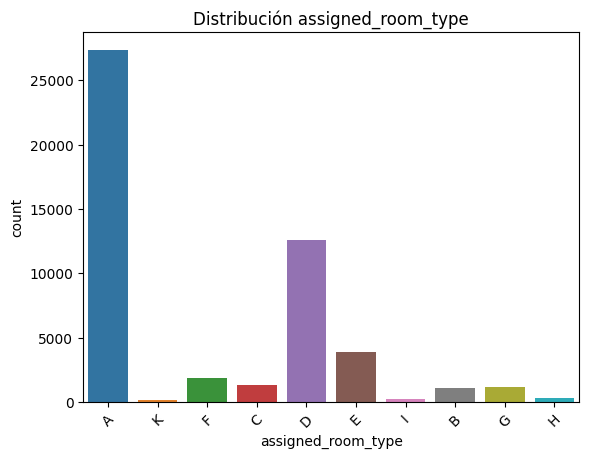

In [ ]:
# Verificamos la distribución de assigned_room_type
plot_count_distribution(hotels, 'assigned_room_type', 'Distribución assigned_room_type')

Mas de la mitad de las reservas se asignaron al tipo de habitacion "A"

## Análisis Bivariado

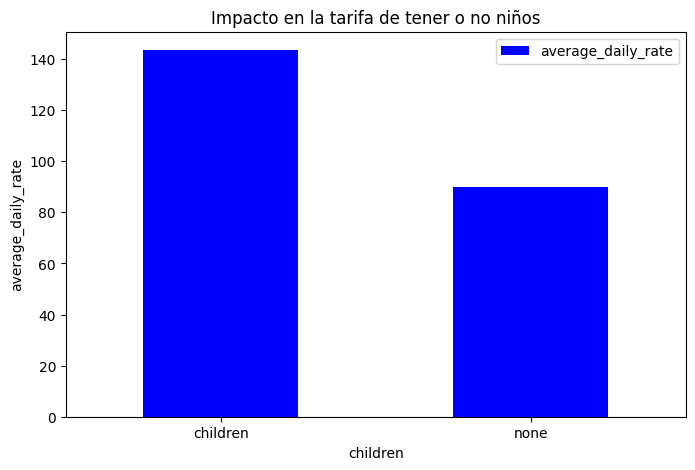

In [ ]:
def plot_pivot_median(df, index_col, values_col, title):
    pivot_table = df.pivot_table(index=index_col, values=values_col, aggfunc='median')
    pivot_table.plot(kind='bar', color='blue', figsize=(8, 5))
    plt.xlabel(index_col)
    plt.ylabel(values_col)
    plt.title(title)
    plt.xticks(rotation=0)
    plt.show()

# Impacto en la tarifa de tener o no niños
plot_pivot_median(hotels, 'children', 'average_daily_rate', 'Impacto en la tarifa de tener o no niños')


Logicamente el promedio de tarifa tienendo niños es mas alto

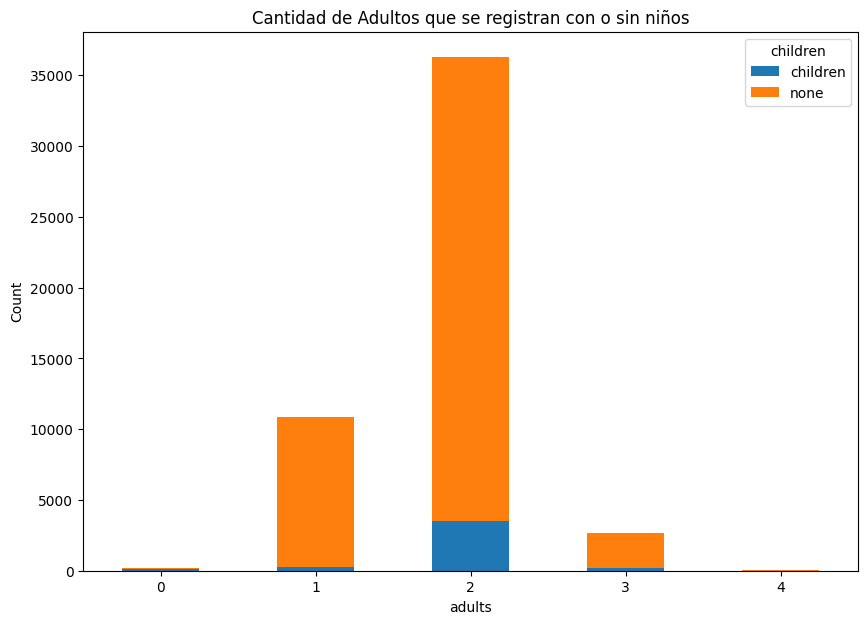

In [ ]:
def plot_count_by_category(df, x_col, y_col, title):
    count_table = df.groupby([x_col, y_col]).size().unstack().fillna(0)
    count_table.plot(kind='bar', stacked=True, figsize=(10, 7))
    plt.xlabel(x_col)
    plt.ylabel('Count')
    plt.title(title)
    plt.xticks(rotation=0)
    plt.show()

# Cantidad de Adultos que se registran con o sin niños
plot_count_by_category(hotels, 'adults', 'children', 'Cantidad de Adultos que se registran con o sin niños')


Esto grafico nos indicaría en principio dos cosas. La mayor parte de los niños asisten con dos adultos, y que en la mayoría de los casos no se registran niños. Ahora, veamos dentro de cada registro de adultos, cuantos niños hay registrados.

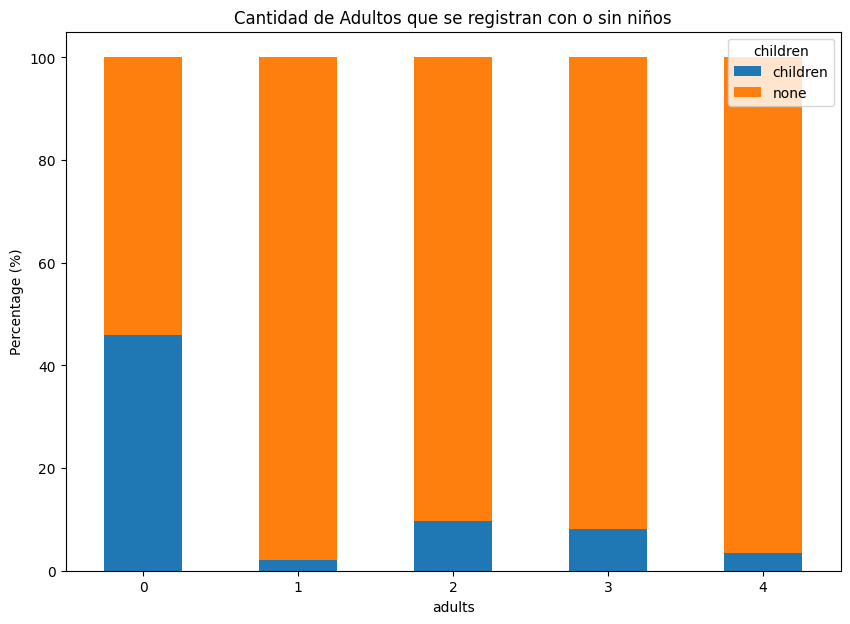

In [ ]:
import matplotlib.pyplot as plt

def plot_percentage_by_category(df, x_col, y_col, title):
    count_table = df.groupby([x_col, y_col]).size().unstack().fillna(0)
    percentage_table = count_table.div(count_table.sum(axis=1), axis=0) * 100
    percentage_table.plot(kind='bar', stacked=True, figsize=(10, 7))
    plt.xlabel(x_col)
    plt.ylabel('Percentage (%)')
    plt.title(title)
    plt.xticks(rotation=0)
    plt.show()

# Cantidad de Adultos que se registran con o sin niños
plot_percentage_by_category(hotels, 'adults', 'children', 'Cantidad de Adultos que se registran con o sin niños')


Okey, interesante lo que se muestra. Casi la mitad de las veces en que el registro de adultos es 0, hay registrado al menos un niño. ¿Será porque se les asigna habitaciones individuales?

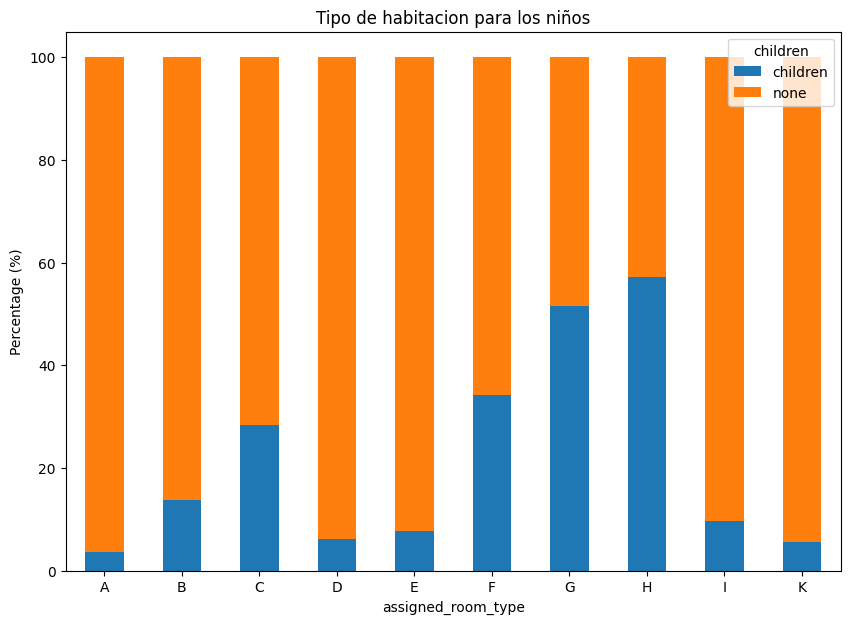

In [ ]:
#Veamos el tipo de habitacion tienen asignadas los niños
plot_percentage_by_category(hotels, 'assigned_room_type', 'children', 'Tipo de habitacion para los niños')

Las habitaciones F-G-H son las que mayormente ocupan niños. ¿Acaso estas mismas son las ocupadas por adultos?

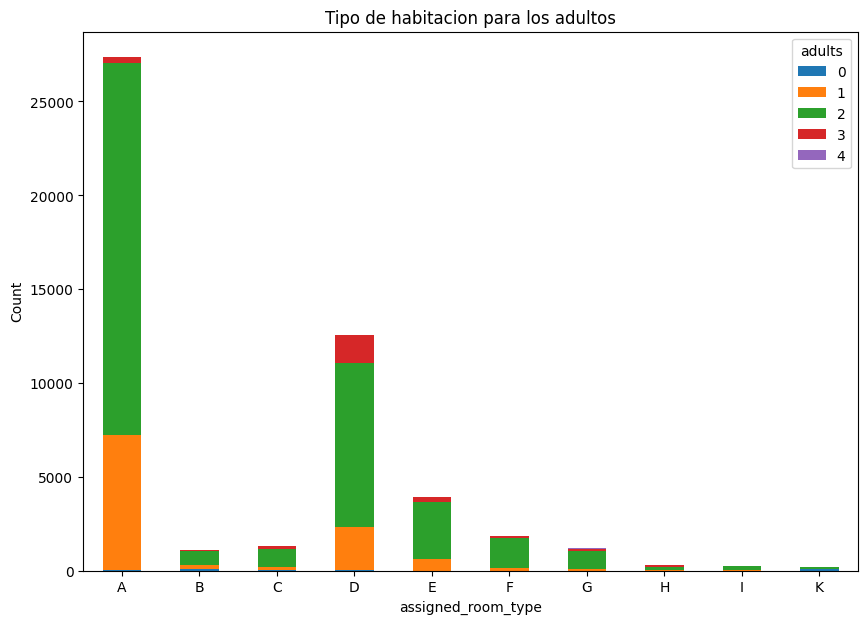

In [ ]:
#Veamos el tipo de habitacion tienen asignadas los adultos
plot_count_by_category(hotels, 'assigned_room_type', 'adults', 'Tipo de habitacion para los adultos')

La mayoria de los adultos van a la habitacion A, habitacion individual o para dos personas (agentes de viaje suelen viajar solos). Probablemente es la misma habiotacion que reservan las parejas, reservando las habitaciones F-G-H para sus hijos.

In [ ]:
hotels.columns

Index(['hotel', 'lead_time', 'stays_in_weekend_nights', 'stays_in_week_nights',
       'adults', 'children', 'meal', 'country', 'market_segment',
       'distribution_channel', 'is_repeated_guest', 'previous_cancellations',
       'previous_bookings_not_canceled', 'reserved_room_type',
       'assigned_room_type', 'booking_changes', 'deposit_type',
       'days_in_waiting_list', 'customer_type', 'average_daily_rate',
       'required_car_parking_spaces', 'total_of_special_requests',
       'arrival_date'],
      dtype='object')

In [ ]:
color = ["#404040", "#CD6889"]

def generate_histogram_chart(data, ver, color_bar, color, title, num):
    fig = px.histogram(
      data,
      x=ver,
      color=color_bar,
      color_discrete_sequence=color,
      marginal="box",
      barmode="group",
      hover_data=data.columns,
      height=540,
      width=840,
      title=title,
    )
    fig.update_traces(opacity= num)
    fig.show()

# Creamos una columna 'Mes_Año' que contiene el mes y el año combinados
hotels['Mes_Año'] = hotels['arrival_date'].dt.strftime('%B %Y')

# Creamos una columna 'Año' que contiene el año
hotels['Mes'] = hotels['arrival_date'].dt.month

# Creamos una columna 'Año' que contiene el año
hotels['Año'] = hotels['arrival_date'].dt.year

# Ordenamos el DataFrame por la columna de fecha 'Mes_Año'
hotels = hotels.sort_values(by='Mes_Año')

generate_histogram_chart(hotels, 'arrival_date', 'children', color , 'Epoca de reservas con niños', 0.8)

No llegamos a apreciar algun tipo de estacionalidad de las reservas con niños, probemos filtrando solo las reservas con niños

In [ ]:
children = hotels[hotels['children'] == "children"]
generate_histogram_chart(children, 'arrival_date', 'children', color , 'Epoca de reservas con niños', 0.8)

In [ ]:
#Veamos solo los adultos solos a ver si tiene la misma estacionalidad en las reservas
adults = hotels[hotels['children'] == "none"]
generate_histogram_chart(adults, 'arrival_date', 'children', color , 'Epoca de reservas solo adultos', 0.8)

Parecieran tener un comportamiento distinto. Mientras que los picos de reservas con niños se presentan entre Julio y Agosto (logico ya que son los meses de verano en el hemisferio norte), los adultos solos tienen una estacionalidad diferente. Estos registran picos de reserva en Septiembre y Octubre, previo a las fiestas, que es cuando las reservas se derrumban.

# Análisis Chi Cuadrado variables categoricas

In [ ]:
# Creamos una lista para guardar las features que deberíamos descartar
features_to_discard = []

# Recorremos la lista de variables categóricas y calculamos el chi cuadrado con "children" como target
def calculate_chi_square(df, target_field, obj_cols):
    from scipy import stats

    for field in obj_cols:
        dep1 = pd.crosstab(df[field], df[target_field])
        chi2, p, dof, expected = stats.chi2_contingency(dep1)
        print(f'{field} vs {target_field}')
        print('Chi-squared Test Statistic:', chi2)
        print('P-value:', p)
        print('Degrees of Freedom:', dof)
        print()
        if p > 0.05:
            features_to_discard.append(field)

# Especifica "children" como la variable objetivo
target_variable = "children"

# Calcula el chi cuadrado para cada variable categórica con "children" como target
calculate_chi_square(hotels, target_variable, obj_cols)

# Veamos las variables que deberían descartarse
print('Características que podrían descartarse:', features_to_discard)

hotel vs children
Chi-squared Test Statistic: 14.79570387727448
P-value: 0.00011980813252744884
Degrees of Freedom: 1

children vs children
Chi-squared Test Statistic: 49986.5306845411
P-value: 0.0
Degrees of Freedom: 1

meal vs children
Chi-squared Test Statistic: 260.15020295538426
P-value: 4.232738104330414e-55
Degrees of Freedom: 4

country vs children
Chi-squared Test Statistic: 508.0552427906635
P-value: 1.157647995326883e-39
Degrees of Freedom: 153

market_segment vs children
Chi-squared Test Statistic: 1365.1763990362674
P-value: 8.39985104717894e-292
Degrees of Freedom: 6

distribution_channel vs children
Chi-squared Test Statistic: 501.5047562563466
P-value: 3.1666454190165745e-107
Degrees of Freedom: 4

reserved_room_type vs children
Chi-squared Test Statistic: 10803.438868371724
P-value: 0.0
Degrees of Freedom: 8

assigned_room_type vs children
Chi-squared Test Statistic: 7296.704811706799
P-value: 0.0
Degrees of Freedom: 9

deposit_type vs children
Chi-squared Test Statist

<ipython-input-33-fcec45c062ba>:4: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.

<ipython-input-33-fcec45c062ba>:8: DeprecationWarning:

`np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



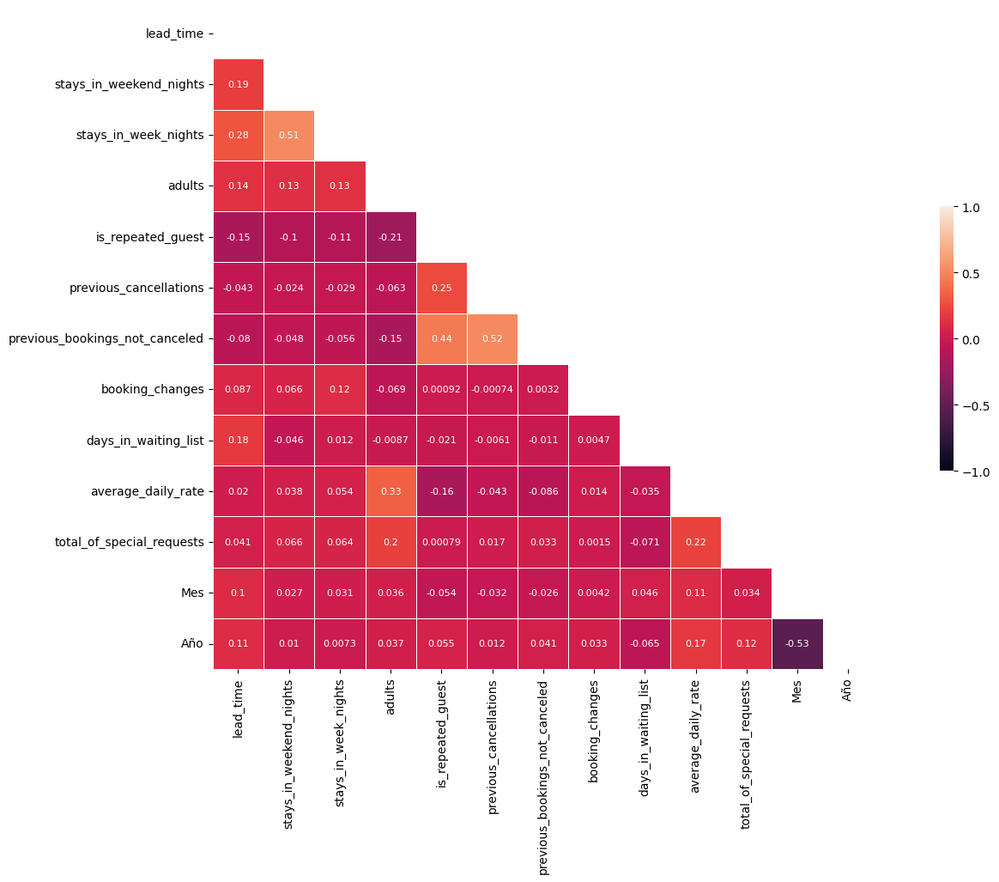

In [ ]:
#Veamos la correlacion que existe entre las variables numericas
# Correlacion entre variables numericas

matriz_correlacion = hotels.corr()

# Graficamos la correlacion entre las variables

mask = np.zeros_like(matriz_correlacion, dtype=np.bool)
mask[np.triu_indices_from(mask)]= True

f, ax = plt.subplots(figsize=(20, 10))

heatmap = sns.heatmap(matriz_correlacion,
                      mask = mask,
                      square = True,
                      linewidths = .5,
                      #cmap = 'coolwarm',
                      cbar_kws = {'shrink': .4,
                                'ticks': [-1, -.5, 0, 0.5, 1]},
                      vmin = -1,
                      vmax = 1,
                      annot = True, annot_kws={"fontsize":8})


ax.set_yticklabels(matriz_correlacion.columns, rotation = 0)
ax.set_xticklabels(matriz_correlacion.columns)

sns.set_style({'xtick.bottom': True}, {'ytick.left': True})

No se observa que entre las variables numericas exista una muy alta correlacion entre las variables. No se observa un par de variables fuertemente correlacionados que pod´ria descartarse.

# Encoding variables categoricas

In [ ]:
#Recordemos las variables categoricas de nuestro dataset
obj_cols

['hotel',
 'children',
 'meal',
 'country',
 'market_segment',
 'distribution_channel',
 'reserved_room_type',
 'assigned_room_type',
 'deposit_type',
 'customer_type',
 'required_car_parking_spaces']

In [ ]:
#Para poder utilizarlas en una prediccion debemos pasarlas a variables numericas. Para ello crearemos nuevas columnas por cada valor unico dentro de las variables categoricas, transormando las mismas en varialbes binarias de 0 y 1
# Itera a través de las columnas categóricas y aplica el One-Hot Encoder
for col in obj_cols:
    one_hot = pd.get_dummies(hotels[col], prefix=col, prefix_sep='_')
    hotels = pd.concat([hotels, one_hot], axis=1)
    hotels.drop(col, axis=1, inplace=True)

hotels.shape

(50000, 218)

Nustro data set paso a tener ahora 218 variables, por lo que implementar un proceso de feauture selection se hace imperativo

# Feature Selection

Hasta ahora hemos:
1. Verificado correlacion entre features numericas, y no hay dos features que esten altamente correlacionadas, lo que agregaria ruido a nuestra predicción.
2. Realizamos la prueba de Chi Cuadrado sobre nuestras variables categoricas en relacion a nuestra variable targuet de la futura predicción, y todas se mostraron estadisticamente significativas
3. Hemos creado variables dummies para pasar nuestras variables categoricas a numericas.

Dada la extension de nuetro dataset ahora, debemos realizar nuevas pruebas estadisticas para reducir la dimensionalidad de nuestro dataset.

Para ello empezaremos por eliminar variables constatnes/cuasi constantes

In [ ]:
# usamos sklearn variancethreshold para descartar variables constantes
import logging
import pandas as pd
import numpy as np
import sklearn
from sklearn import preprocessing
import logging
from sklearn.feature_selection import VarianceThreshold
from sklearn.preprocessing import MinMaxScaler

#Primero definimos una funcion para escalar nuestro dataset
def MinMaxScaler(df):

    df.set_index("id_pdv_unique", inplace=True)

    # normalize data()

    scaler_auto = preprocessing.MinMaxScaler().fit(df)
    scaled_auto = scaler_auto.transform(df)
    scaled_auto = pd.DataFrame(
        scaled_auto,
        index=df.index,
        columns=df.columns,
    ).reset_index()

    return scaled_auto

#Definimos selector para MDT_AUTO
def variance_threshold(df:pd.DataFrame,th):
    var_thres=VarianceThreshold(threshold=th)
    df = df.toPandas()
    var_thres.fit(df)
    new_cols = var_thres.get_support()
    return df.iloc[:,new_cols]

In [ ]:
hotels_normalized = MinMaxScaler(hotels)

KeyError: ignored

In [ ]:
hotels_normalized_filtered = variance_threshold(hotels_normalized,0.01)

In [ ]:
#Filtramos columnas en nuestro dataset original
def columns(df, df_norm):
  columns=df_norm.columns
  df = df.filter(items=columns)
  return df.reset_index()

In [ ]:
hotels = columns(hotels,hotels_normalized_filtered)

## Part II - Modeling

We will build the best model to predict which actual hotel stays included children/babies, and which did not:

In [ ]:
#
# Develop Machine/Statistical Learning models to predict the target variable...
#

## Part III - Results & Conclusions

In [ ]:
#
# List your key insights / findings and conclusions...
#